In [3]:
%reload_ext autoreload
%autoreload 2

import sys
import os
import sklearn
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt

from osgeo import gdal
from matplotlib import patches as mpl_patches
from matplotlib.colors import Colormap
from mpl_toolkits.mplot3d import Axes3D
from sklearn.manifold import TSNE, Isomap, SpectralEmbedding
from sklearn import cluster, decomposition
from sklearn.cluster import SpectralClustering, KMeans, AgglomerativeClustering, AffinityPropagation

sys.path.insert(1, os.path.join(sys.path[0], ".."))
# reproduction module
from reproduction import analysis
from reproduction.models import autoencoder
from reproduction.pipeline import load as pipeline
from reproduction.analysis import AEData, plot_cluster_channel_distributions, get_tif_metadata
#from reproduction.analysis import plot_cluster_samples, plot_all_cluster_samples
from reproduction.pipeline.load import load_data
from reproduction.pipeline import into_record

In [54]:
import seaborn as sns

In [63]:
from  scipy.stats import skew, kurtosis

In [64]:
import scipy as sc

# m9-22 (model15b trained by only ocean data )

In [2]:
model_dir = "/home/tkurihana/clouds/output/m9-22_oceans/"

def load_model(model_dir, name):
    with open(model_dir + name + ".json", "r") as f:
        model = tf.keras.models.model_from_json(f.read())
    model.load_weights(model_dir + name + ".h5")
    return model

encoder = load_model(model_dir, "encoder")
#decoder = load_model(model_dir, "decoder")
# encoder, decoder = autoencoder(shape=(None, None, 7), data_format="channels_last"
encoder.load_weights(model_dir + "encoder.h5")
#decoder.load_weights(model_dir + "decoder.h5")

/home/tkurihana/.conda/envs/py3501/lib/python3.6/site-packages/tensorflow/python/keras/layers/core.py:791: UserWarning: models is not loaded, but a Lambda layer uses it. It may cause errors.
  , UserWarning)


In [4]:
# open/closed cell data dir
CLOSEDATADIR="/home/tkurihana/scratch-midway2/clouds/2017JAN01MOD09GA_close"
CLOSEDS = CLOSEDATADIR+"/closed.tfrecord"
OPENDATADIR="/home/tkurihana/scratch-midway2/clouds/2017JAN01MOD09GA_open"
OPENS = OPENDATADIR+"/open.tfrecord"

# same brightness but no texture to open/closed cell data dir
BCLOSEDATADIR="/home/tkurihana/scratch-midway2/clouds/2017JAN30MOD09GA_ambiguous_closed"
BCLOSEDS = BCLOSEDATADIR+"/bright_closed.tfrecord"
BOPENDATADIR="/home/tkurihana/scratch-midway2/clouds/2017JAN31MOD09GA_ambiguous_open"
BOPENS = BOPENDATADIR+"/bright_open.tfrecord"

## Load data

In [8]:
oimgs_array = analysis._get_imgs(load_data(OPENS, encoder.input_shape[1:], repeat=False), n=30)
cimgs_array = analysis._get_imgs(load_data(CLOSEDS, encoder.input_shape[1:], repeat=False), n=30)
_oimgs_array = analysis._get_imgs(load_data(BOPENS, encoder.input_shape[1:], repeat=False), n=30)
_cimgs_array = analysis._get_imgs(load_data(BCLOSEDS, encoder.input_shape[1:], repeat=False), n=30)

check images

In [11]:
oimgs_array[0].shape

(128, 128, 7)

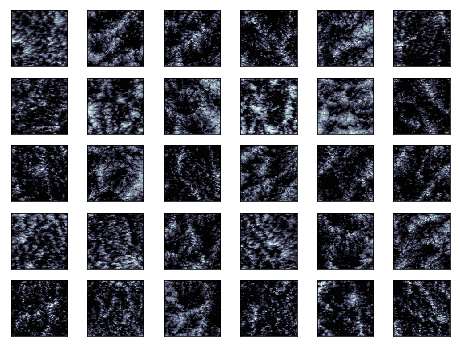

In [17]:
fig = plt.figure(figsize=(8,6))
row = 5; col = 6
for index, i in enumerate(oimgs_array[:30]):
    ax = plt.subplot(row, col, index+1)
    plt.imshow(i[:,:,0], cmap='bone')
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)
plt.show()

## Merge labelled images for classification 

In [31]:
def img_concatenation(imgs):
    col1 = np.concatenate([x for x in imgs[0:6]], axis=1)
    col2 = np.concatenate([x for x in imgs[6:12]], axis=1)
    col3 = np.concatenate([x for x in imgs[12:18]], axis=1)
    col4 = np.concatenate([x for x in imgs[18:24]], axis=1)
    col5 = np.concatenate([x for x in imgs[24:30]], axis=1)
    print(col1.shape)
    array_list = [col1, col2, col3, col4]
    array = np.concatenate(array_list, axis=0)
    return array

In [33]:
oimg = img_concatenation(oimgs_array)

(128, 768, 7)


In [34]:
oimg.shape

(512, 768, 7)

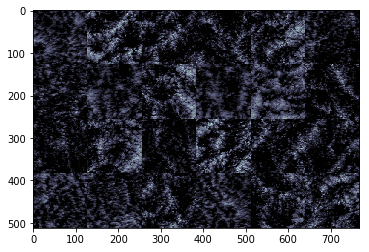

In [35]:
plt.figure()
plt.imshow(oimg[:,:,0], cmap='bone')

In [36]:
cimg = img_concatenation(cimgs_array)
_oimg = img_concatenation(_oimgs_array)
_cimg = img_concatenation(_cimgs_array)

(128, 768, 7)
(128, 768, 7)
(128, 768, 7)


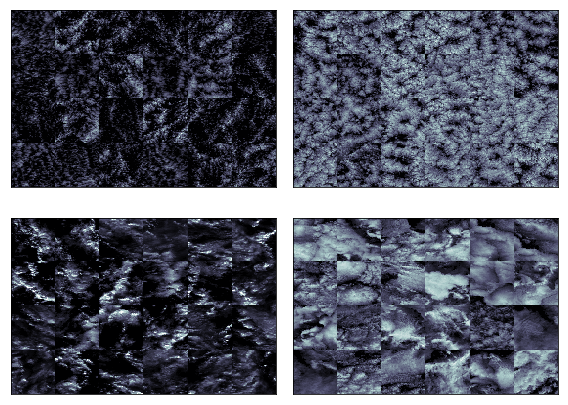

In [39]:
# check images
fig = plt.figure(figsize=(8,6))
for idx, i in enumerate([oimg, cimg, _oimg, _cimg]):
    ax = plt.subplot(2,2,idx+1)
    plt.imshow(i[:,:,0], cmap='bone')
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)
fig.tight_layout()
plt.show()

In [41]:
img1 = np.concatenate((oimg, cimg), axis=1)
img2 = np.concatenate((_oimg, _cimg), axis=1)
img = np.concatenate((img1, img2), axis=0)

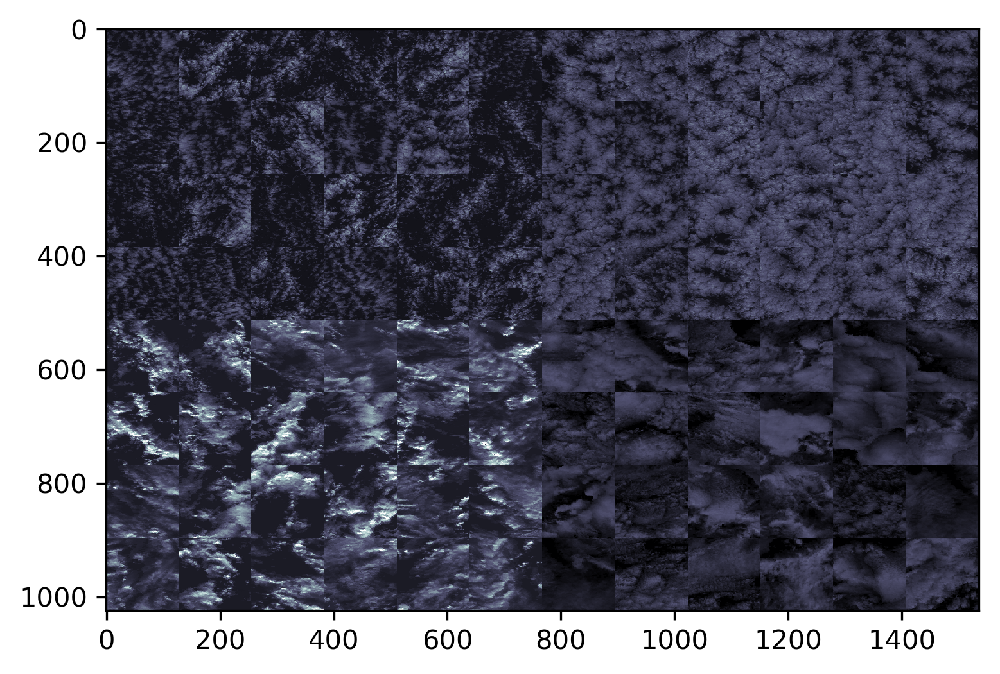

In [53]:
# save img array as png & tiff file
from PIL import Image
import io

fig = plt.figure(dpi=300)
plt.imshow(img[:,:,0], cmap='bone')
#plt.savefig("./concatenated_labelled_img.png")

png  = io.BytesIO()
fig.savefig(png,format="png")
tiff = Image.open(png)
tiff.save("./concatenated_labelled.tiff")
png.close()

In [44]:
swath = img
print(swath.shape)

(1024, 1536, 7)


In [45]:
swath_mean = swath.mean(axis=(0,1))
swath_std = swath.std(axis=(0,1))
patches = []

stride = 128
patch_size = 128

patches = []
for i in range(0, swath.shape[0], stride):
    row = []
    for j in range(0, swath.shape[1], stride):
        if i + patch_size <= swath.shape[0] and j + patch_size <= swath.shape[1]:
            p = swath[i:i + patch_size, j:j + patch_size].astype(float)
            p -= swath_mean
            p /= swath_std
            
            row.append(p)
    if row:
        patches.append(row)
            
patches = np.stack(patches)

In [49]:
SHAPE = 128, 128, 7

In [48]:
# Color scheme by Ricardo
colors = ["#833f2c",
"#016dec",
"#5cb925",
"#e125a2",
"#2f8900",
"#ff95f9",
"#009650",
"#bb0075",
"#8bd890",
"#d30063",
"#00c7b1",
"#e63e2c",
"#029ebe",
"#f0ae00",
"#b98fff",
"#e1c54c",
"#6e3c92",
"#7ad8b4",
"#ff5655",
"#375c16",
"#ff5677",
"#75481c",
"#ffa2d2",
"#9b280d",
"#ffa47a",
"#952f23",
"#ff804b"]

## Agglomerative Clustering towards labelled image

In [46]:
def _anl_agl(encoder, patches, clusters=0):
    # clustering
    _encs = encoder.predict(patches.reshape((-1, 128, 128, 7)))
    method = AgglomerativeClustering(n_clusters=clusters)
    features = _encs.mean(axis=(1,2))
    patches_labels = method.fit_predict(features).reshape(patches.shape[:2])
    return patches_labels

In [47]:
def _plotting(swath, patches,patches_labels, SHAPE, colors, ncluster=0):
    line_width = 4
    fig, a = plt.subplots(figsize=(80,80))
    plt.imshow(swath[:,:,0], cmap="bone")
    rects = []   
    for i in range(patches.shape[0]):
        for j in range(patches.shape[1]):
            a.add_patch(mpl_patches.Rectangle(
                (j * SHAPE[0] + line_width , i * SHAPE[1] + line_width ),
                width=SHAPE[0] - line_width * 2,
                height=SHAPE[1] - line_width * 2,
                linewidth=10,
                edgecolor=colors[patches_labels[i,j]],
                facecolor="none"
            ))
            centerx = 64*(2*j+1) #+1
            centery = 64*(2*i+1) #+1
            # add label as text
            plt.text(centerx, centery, str(patches_labels[i,j]), 
                 fontsize=100,weight='bold', 
                 color=colors[patches_labels[i,j]])
    plt.title(" ## %d cluster ## " %ncluster, fontsize=100)
    plt.show()

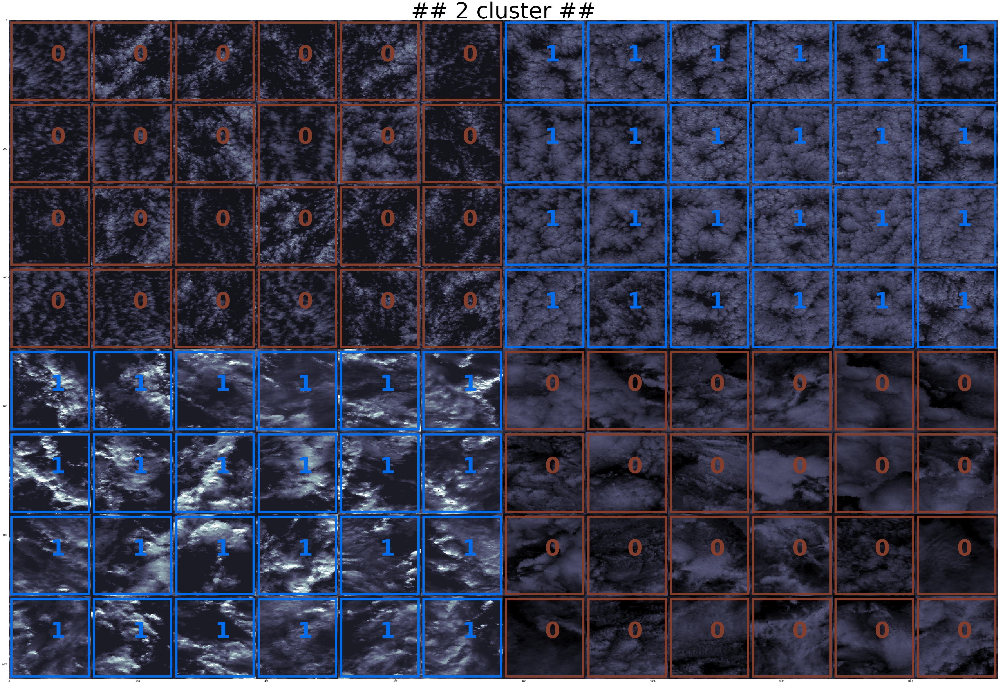

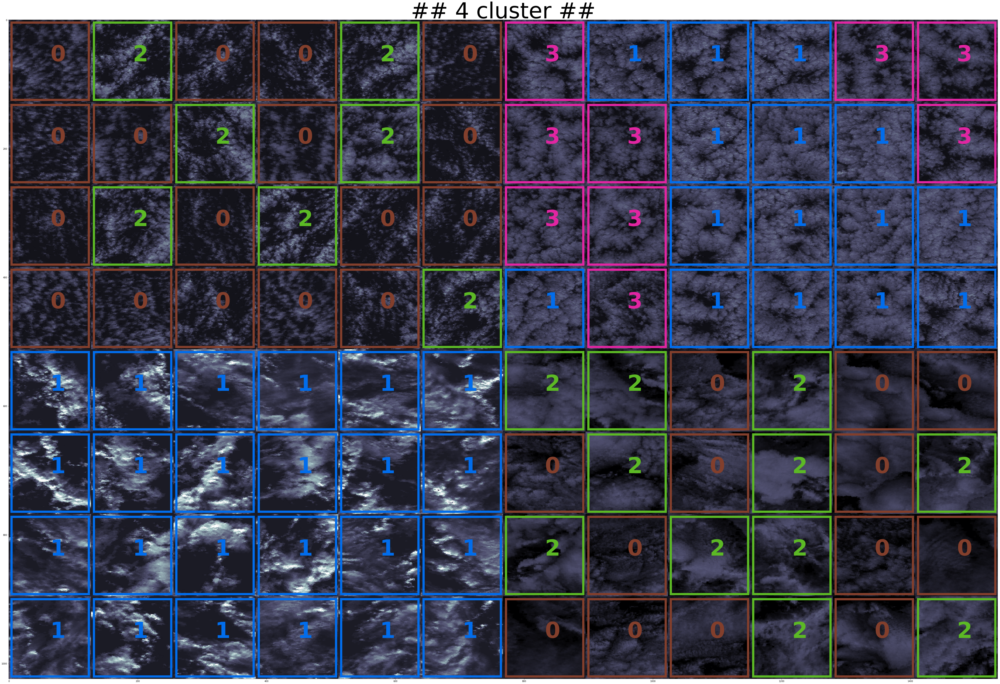

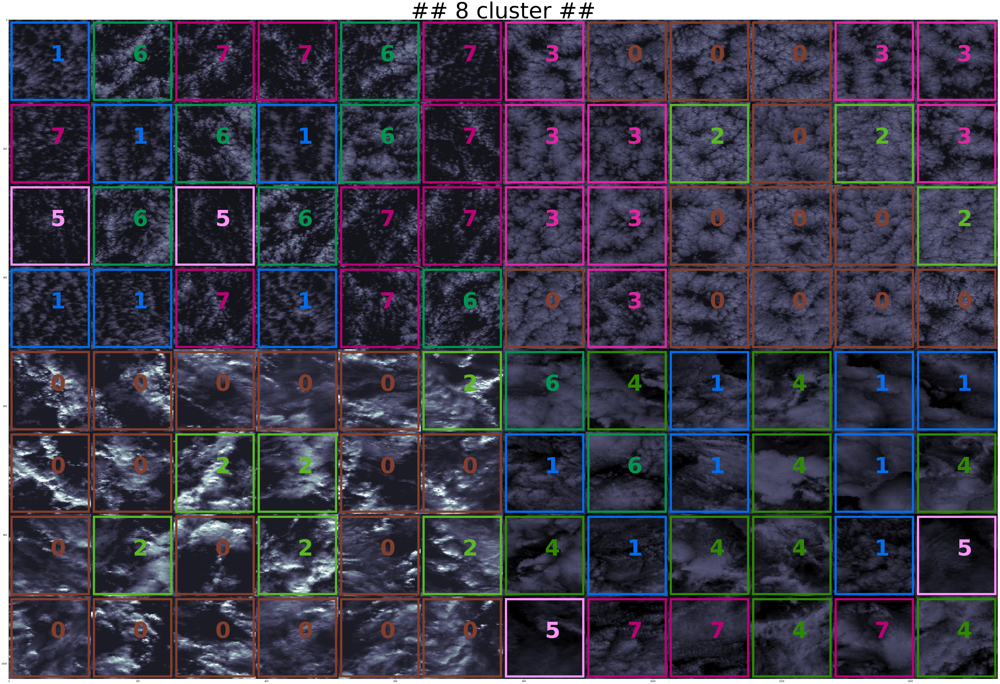

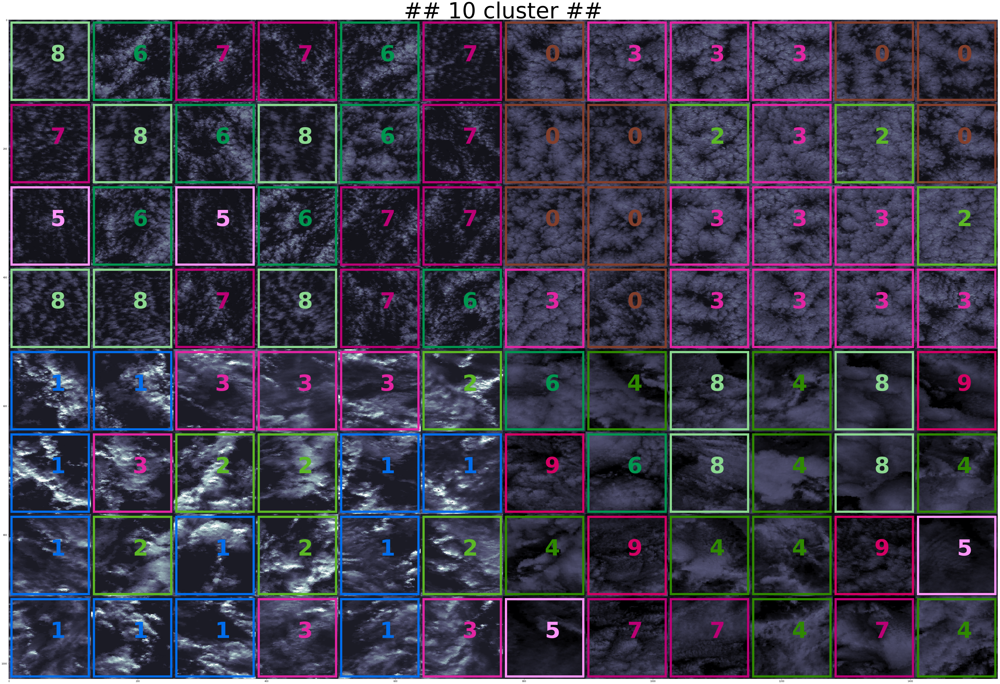

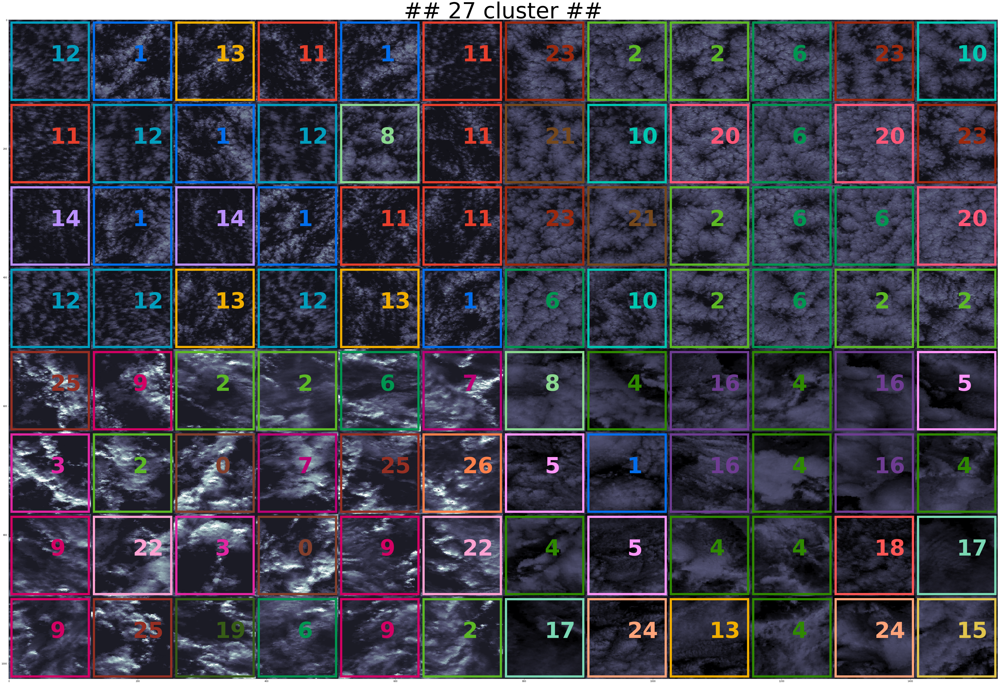

In [50]:
for icluster in [2,4,8,10,27]:
    _patches_labels = _anl_agl(encoder, patches, clusters=icluster)
    _plotting(swath, patches,_patches_labels, SHAPE, colors, ncluster=icluster)

## Heatmap to assess tensor values

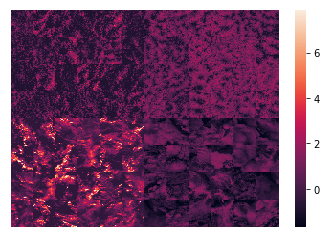

In [56]:
sns.heatmap(img[:,:,0], xticklabels=False, yticklabels=False)

## Mean value of strengthen of radiation in each labelled regions

In [67]:
def _stats(x, label="XXX"):
    mean = np.mean(x[:,:,0])
    stdv = np.std(x[:,:,0])
    skew = sc.stats.skew(x[:,:,0].flatten())
    kurt = sc.stats.kurtosis(x[:,:,0].flatten())
    print()
    print("      ==== Processing %s information ====" %label)
    print(" ##   Mean radiation of %s       = %f ## " %(label, mean) )
    print(" ##   Stdv radiation of %s       = %f ## " %(label, stdv) )
    print(" ##   Skew radiation of %s       = %f ## " %(label, skew) )
    print(" ##   Kurt radiation of %s       = %f ## " %(label, kurt) )

In [69]:
for img, ilabel in zip ([oimg, cimg, _oimg, _cimg], 
                        ["OPEN", "CLOSED", "OPEN ANL", "CLOSED ANL"] ):
    _stats(img, label=ilabel)


      ==== Processing OPEN information ====
 ##   Mean radiation of OPEN       = -0.094400 ## 
 ##   Stdv radiation of OPEN       = 0.904880 ## 
 ##   Skew radiation of OPEN       = 1.259447 ## 
 ##   Kurt radiation of OPEN       = 1.086118 ## 

      ==== Processing CLOSED information ====
 ##   Mean radiation of CLOSED       = 0.686653 ## 
 ##   Stdv radiation of CLOSED       = 0.851405 ## 
 ##   Skew radiation of CLOSED       = -0.289457 ## 
 ##   Kurt radiation of CLOSED       = -0.607868 ## 

      ==== Processing OPEN ANL information ====
 ##   Mean radiation of OPEN ANL       = 0.834722 ## 
 ##   Stdv radiation of OPEN ANL       = 1.501768 ## 
 ##   Skew radiation of OPEN ANL       = 1.681457 ## 
 ##   Kurt radiation of OPEN ANL       = 3.208350 ## 

      ==== Processing CLOSED ANL information ====
 ##   Mean radiation of CLOSED ANL       = -0.147783 ## 
 ##   Stdv radiation of CLOSED ANL       = 0.829451 ## 
 ##   Skew radiation of CLOSED ANL       = 0.173593 ## 
 ##   Kurt r

## Distribution of radiance values

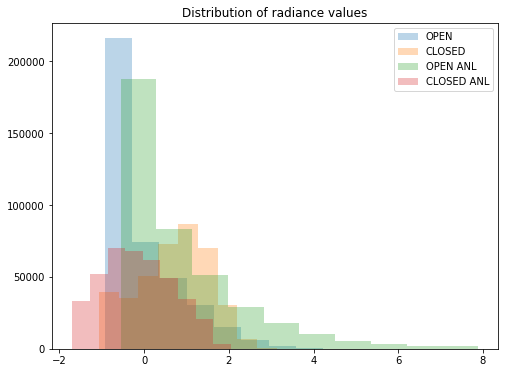

In [70]:
plt.figure(figsize=(8,6))
for img, ilabel in zip ([oimg, cimg, _oimg, _cimg], 
                        ["OPEN", "CLOSED", "OPEN ANL", "CLOSED ANL"] ):\
    plt.hist(img[:,:,0].flatten(), alpha=0.3, label=ilabel)
plt.title("Distribution of radiance values")
plt.legend()
plt.show()

# m15b (original  trained model by both land and ocean)

## Agglomerative Clustering

In [71]:
# outputdata dir
OUTPUTDIR="/project/foster/clouds/output"
ENCODER_DEF = OUTPUTDIR+"/mod09cnn15b/encoder.json"
ENCODER_WEIGHTS = OUTPUTDIR+"/mod09cnn15b/encoder-585000.h5"
ENCODINGS = OUTPUTDIR+"/mod09cnn15b/encodings/m15b-enc"

In [72]:
with open(ENCODER_DEF,"r") as f:
    _encoder = tf.keras.models.model_from_json(f.read())
_encoder.load_weights(ENCODER_WEIGHTS)

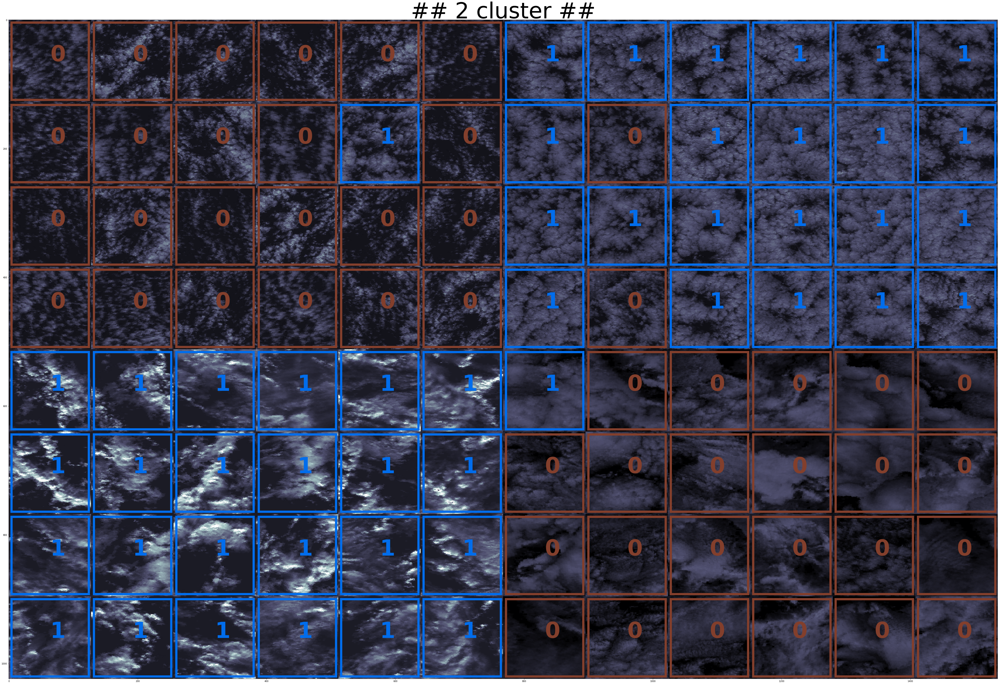

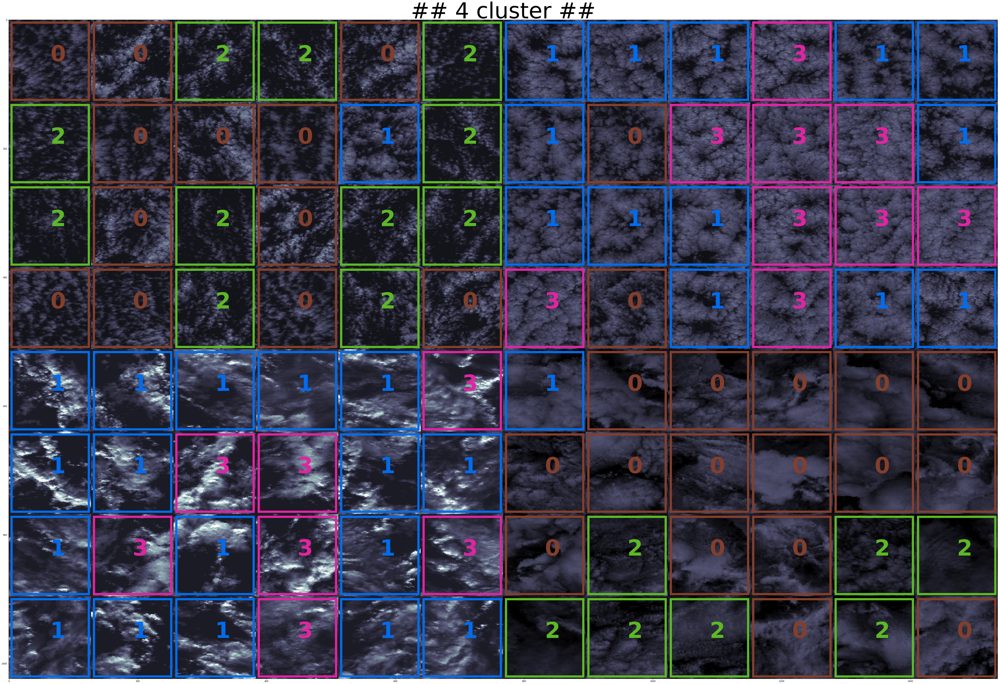

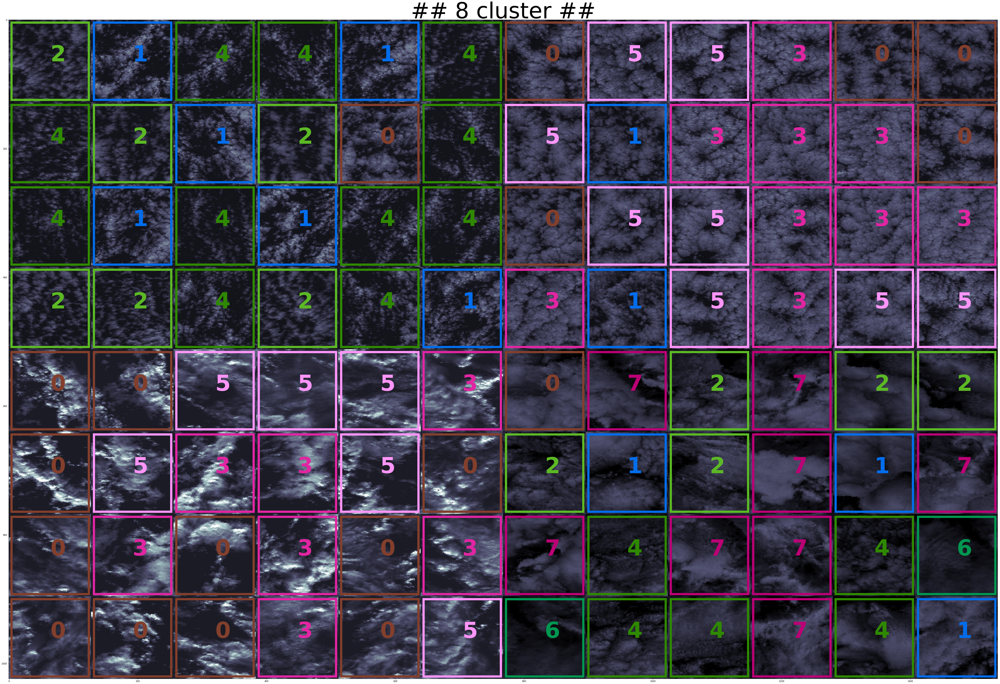

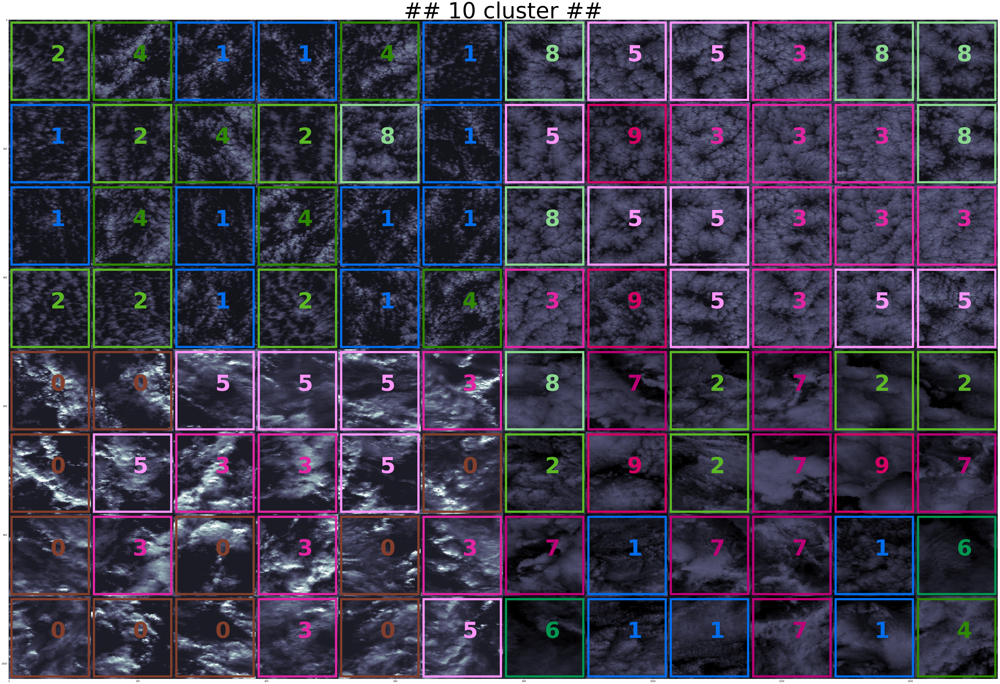

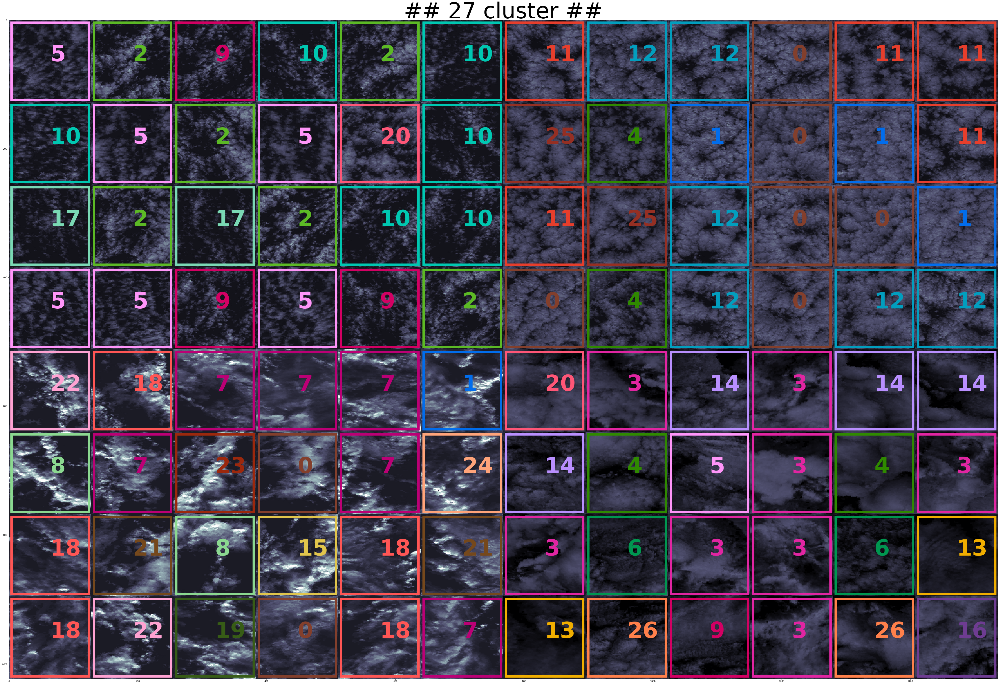

In [73]:
for icluster in [2,4,8,10,27]:
    _patches_labels = _anl_agl(_encoder, patches, clusters=icluster)
    _plotting(swath, patches,_patches_labels, SHAPE, colors, ncluster=icluster)